In [ ]:
# @title 1. Reading the csv file
import pandas as pd
data = pd.read_csv('ca-GrQc.txt',header=None)
data

,0
0,# Directed graph (each unordered pair of nodes...
1,# Collaboration network of Arxiv General Relat...
2,# Nodes: 5242 Edges: 28980
3,# FromNodeId\tToNodeId
4,3466\t937
...,...
28979,10154\t9224
28980,10154\t16830
28981,11113\t21723
28982,11113\t23836


In [ ]:
# @title 2. Saving elements in a Data Structure

# Saving the data in a list
list_1 = []
for i in range(4,28980):
    Y = str(data.iloc[i,0])
    list_1.append(Y)

# Splitting the data and storing single elements in another list
list_2 = []
for i in range(len(list_1)):
    splitted_list = list_1[i].split('\t')
    list_2.append(splitted_list)

# Saving elements in their own list preserving the directed edges
From_node = []
To_node = []
for i in list_2:
    E = i[0]
    From_node.append(E)
    F = i[1]
    To_node.append(F)
print(f" From node : {From_node[:100]}")
print(f"To node : {To_node[:100]}")

 From node : ['3466', '3466', '3466', '3466', '3466', '3466', '3466', '3466', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '10310', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5052', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '5346', '15159', '15159', '15159', '15159', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '19640', '10243']
To node : ['937', '5233', '8579', '10310', '15931', '17038', '18720', '19607', '1854', '3466', '4583', '5233', '9572', '10841', '13056', '14982

Graph named 'Authors vs Co-authors' with 5242 nodes and 14496 edges


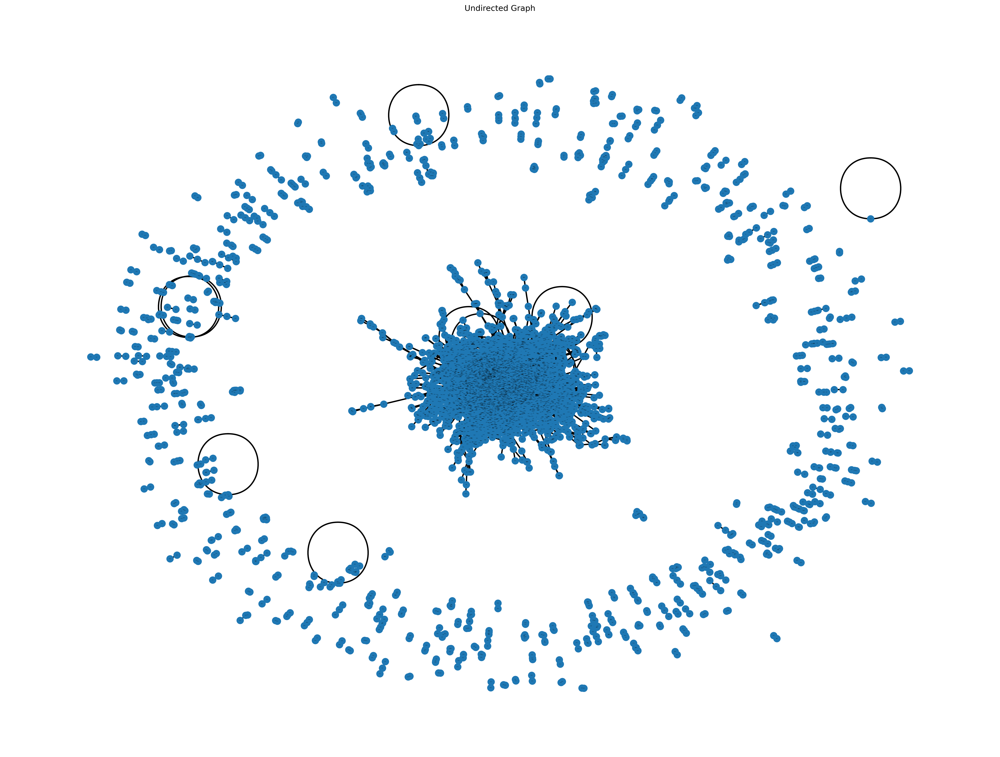

In [ ]:
# @title 3. Plotting the Graph
import networkx as nx
import matplotlib.pyplot as plt

my_dpi = 300
plt.figure(figsize=(8000/my_dpi, 6000/my_dpi), dpi = my_dpi)
G = nx.Graph(name='Authors vs Co-authors')
edges = zip(From_node, To_node)
G.add_edges_from(edges)
pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, node_size=100)
nx.draw_networkx_edges(G, pos, edgelist=G.edges(), width=2)
nx.draw_networkx_labels(G, pos, font_size=0, font_family="sans-serif")
print(G)
plt.title("Undirected Graph")
plt.axis("OFF")
plt.savefig('graph.png', dpi = my_dpi)
plt.show()

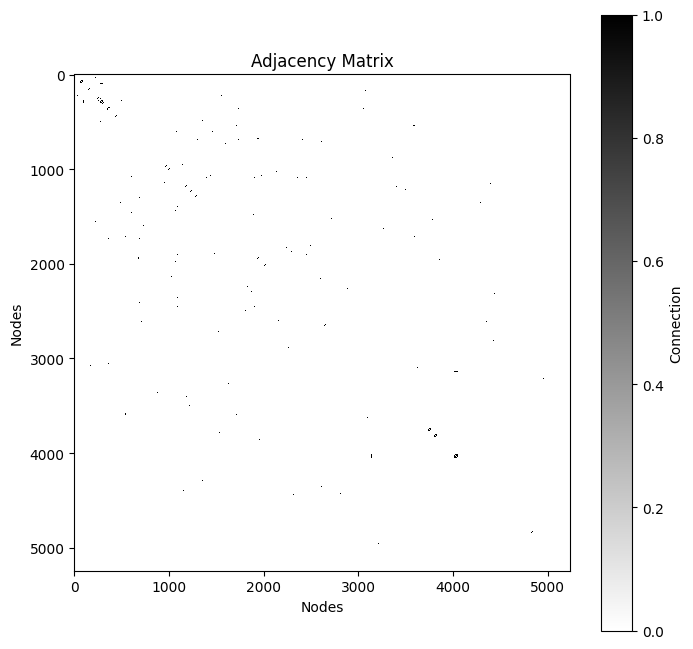

In [ ]:
# @title 4. Calculating and Plotting the Adjacency Matrix
# import networkx as nx

A = nx.adjacency_matrix(G)


A_dense = A.todense()
plt.figure(figsize=(8, 8))
plt.imshow(A_dense, cmap='binary', interpolation='none')
plt.title('Adjacency Matrix')
plt.xlabel('Nodes')
plt.ylabel('Nodes')
plt.colorbar(label='Connection')
plt.savefig('adjmatrix.png', dpi = my_dpi)
plt.show()



Total number of Cliques: 3906


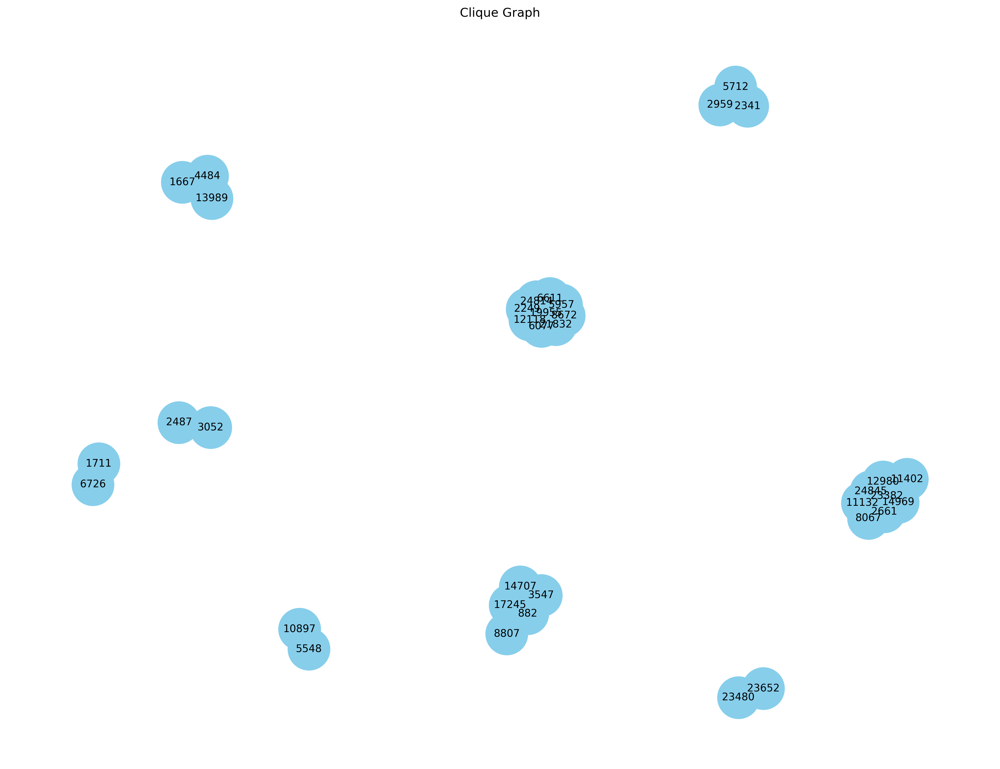

In [ ]:
# @title 5. Calculating and Plotting the Cliques
cliq = nx.find_cliques(G)
clique_list = list(cliq)

print("Total number of Cliques: " + str(len(clique_list)))

C = nx.Graph()

for x in clique_list[:12]:
  for i in range(len(x)):
    for j in range(i+1,len(x)):
       C.add_edge(x[i],x[j])
my_dpi = 300
plt.figure(figsize=(4000/my_dpi, 3000/my_dpi), dpi = my_dpi)
nx.draw(C,with_labels=True, node_color='skyblue', node_size=1000, edge_color='black', linewidths=10, font_size=10)

plt.title('Clique Graph')
plt.savefig('clique.png', dpi = my_dpi)
plt.show()




In [ ]:
# @title 6. Calculating the triangles
triangles = nx.triangles(G)

last_20_triangles = dict(list(triangles.items())[-20:])
for node, triangle_count in last_20_triangles.items():
    print(f"Node {node}: Number of triangles = {triangle_count}")

Node 19314: Number of triangles = 10
Node 19880: Number of triangles = 10
Node 25543: Number of triangles = 10
Node 26019: Number of triangles = 10
Node 26048: Number of triangles = 10
Node 24820: Number of triangles = 0
Node 20707: Number of triangles = 0
Node 5486: Number of triangles = 0
Node 8366: Number of triangles = 0
Node 5261: Number of triangles = 0
Node 6282: Number of triangles = 0
Node 18908: Number of triangles = 0
Node 25531: Number of triangles = 0
Node 12050: Number of triangles = 0
Node 5364: Number of triangles = 0
Node 14: Number of triangles = 0
Node 14171: Number of triangles = 0
Node 14845: Number of triangles = 1
Node 5232: Number of triangles = 1
Node 19521: Number of triangles = 1


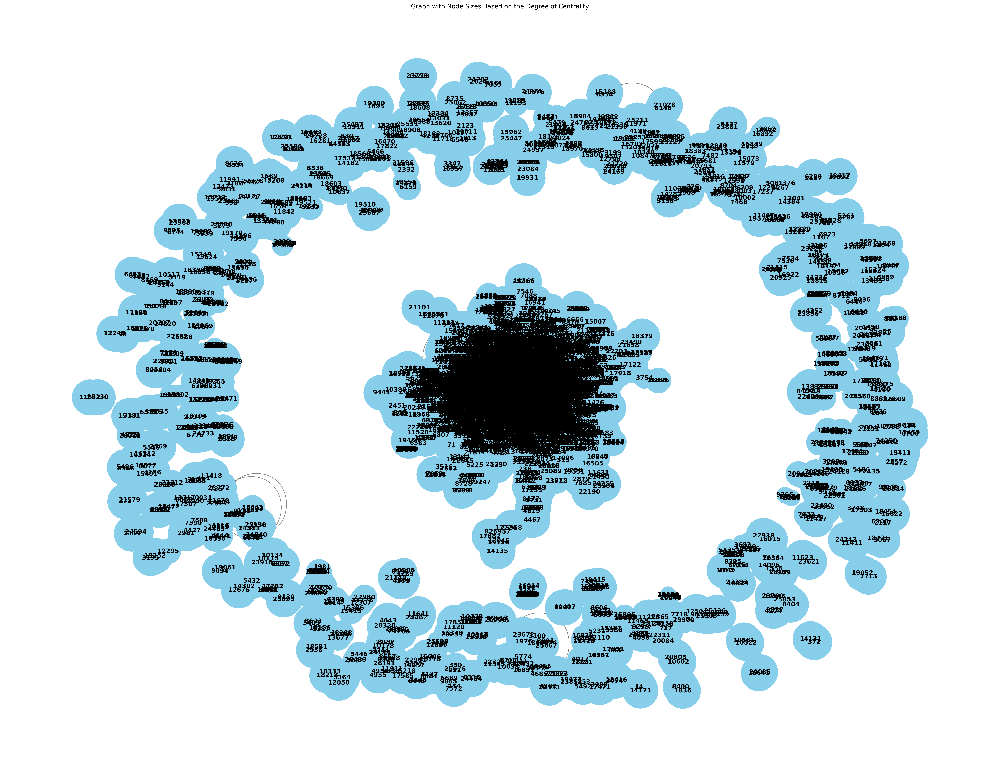

In [ ]:
# @title 7. Calculating the Degree of Centrality and Plotting the Graph
# Enlarging the authors that have most centrality

degree_centrality = nx.degree_centrality(G)

node_sizes = [0.9 / degree_centrality[node] for node in G.nodes]
node_sizes_transformed = [300 * (size ** 0.9) for size in node_sizes]
my_dpi = 300
plt.figure(figsize=(8000/my_dpi, 6000/my_dpi), dpi = my_dpi)
nx.draw(G, with_labels=True, font_weight='bold', node_size=node_sizes, node_color='skyblue', edge_color='gray')
plt.title('Graph with Node Sizes Based on the Degree of Centrality')
plt.savefig('centrality.png', dpi = my_dpi)
plt.show()

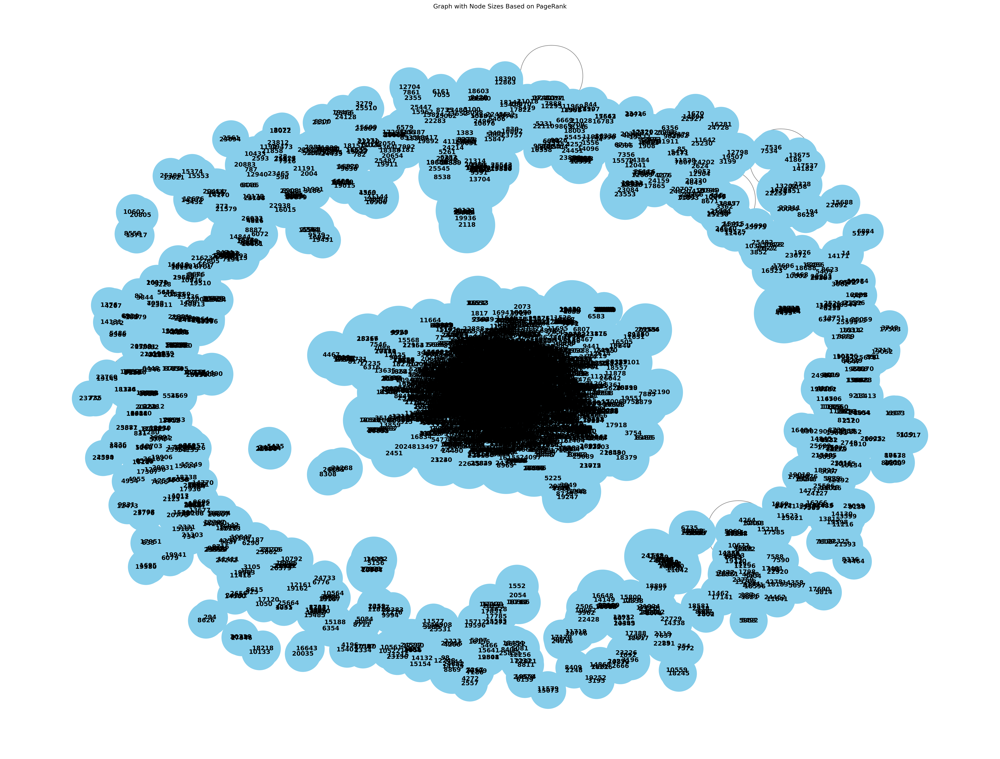

In [ ]:
# @title 8. Calculating the PageRank and Plotting the Graph
# Enlarging the authors with highest rank

pagerank = nx.pagerank(G)

node_sizes = [0.9 / pagerank[node] for node in G.nodes]
node_sizes_transformed = [300 * (size ** 0.9) for size in node_sizes]
my_dpi = 300
plt.figure(figsize=(8000/my_dpi, 6000/my_dpi), dpi = my_dpi)
nx.draw(G, with_labels=True, font_weight='bold', node_size=node_sizes, node_color='skyblue', edge_color='gray')
plt.title('Graph with Node Sizes Based on PageRank')
plt.savefig('pagerank.png', dpi = my_dpi)
plt.show()

In [ ]:
# @title 9. Storing the data in a dictionary
mapped_nodes = {}
for i in range(len(From_node)):
  from_node = From_node[i]
  to_node = To_node[i]
  if from_node in mapped_nodes:
    mapped_nodes[from_node].append(to_node)
  else:
    mapped_nodes[from_node] = [to_node]

# Only printing last 20 nodes for better clarity
first_20_elements = dict(list(mapped_nodes.items())[:20])
for key, value in first_20_elements.items():
    print(f'{key}:{value}')

3466:['937', '5233', '8579', '10310', '15931', '17038', '18720', '19607']
10310:['1854', '3466', '4583', '5233', '9572', '10841', '13056', '14982', '16310', '19640', '23855', '24372', '24814']
5052:['899', '1796', '2287', '3096', '3386', '4472', '5346', '5740', '6094', '6376', '9124', '10235', '10427', '10597', '15159', '16148', '16741', '18235', '18549', '19297', '20511', '20595', '20613', '24371', '24559', '24731', '25102', '25271', '25396']
5346:['1658', '4822', '5052', '6864', '7689', '7926', '9124', '10268', '12971', '15159', '18600', '20421', '20886', '21048', '22393', '23186', '23214', '23298', '23945', '24939']
15159:['5052', '5346', '20421', '22393']
19640:['339', '624', '3731', '4743', '5407', '6610', '6700', '8045', '9099', '9639', '9785', '10310', '12141', '15184', '15784', '18719', '19870', '20532', '22527', '23576', '23577', '23649', '24199', '24293', '25201']
10243:['6774', '8049', '8053', '8517', '10235', '11964', '15538', '16694', '18648', '19423', '21012', '22457', '2

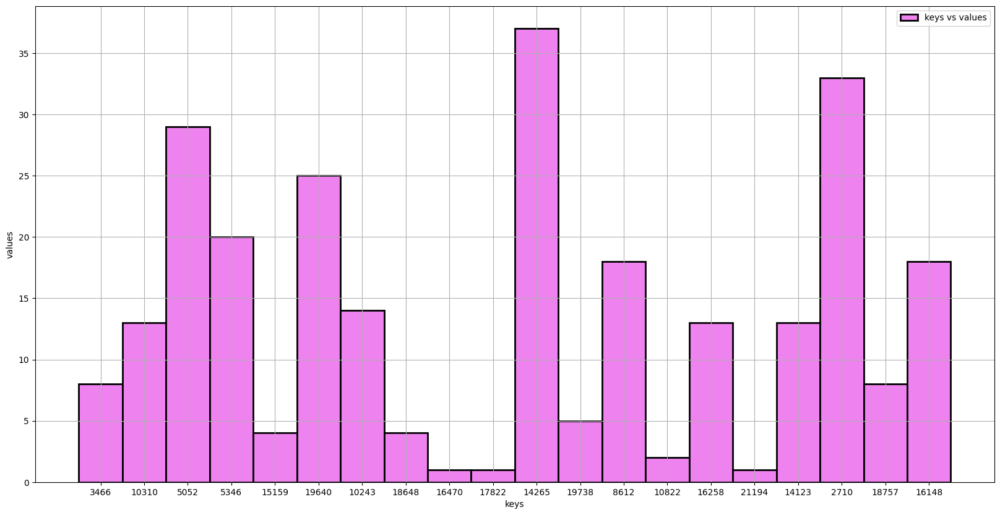

max_key is 21012
max_value is 81


In [ ]:
# @title 10. Storing only the numbers of Coauthors for each Author
# to simplify calculations
import matplotlib.pyplot as plt

mapped_keys_values = {}
for keys,values in mapped_nodes.items():
  mapped_keys_values[keys] = len(values)

# Only printing last 20 nodes for better clarity
list_1 = [x for x in mapped_keys_values.keys()]
list_2 = [y for y in mapped_keys_values.values()]
plt.figure(figsize=(20,10))
plt.bar(list_1[:20],list_2[:20], label = 'keys vs values',color = 'violet',edgecolor="black",width=1,linewidth=2)
plt.xlabel('keys')
plt.ylabel('values')
plt.legend()
plt.grid(True)
plt.show()

# Getting most prolific author
max_key = max(mapped_keys_values, key = lambda x:mapped_keys_values[x])
max_value = mapped_keys_values[max_key]

print(f"max_key is {max_key}")
print(f"max_value is {max_value}")

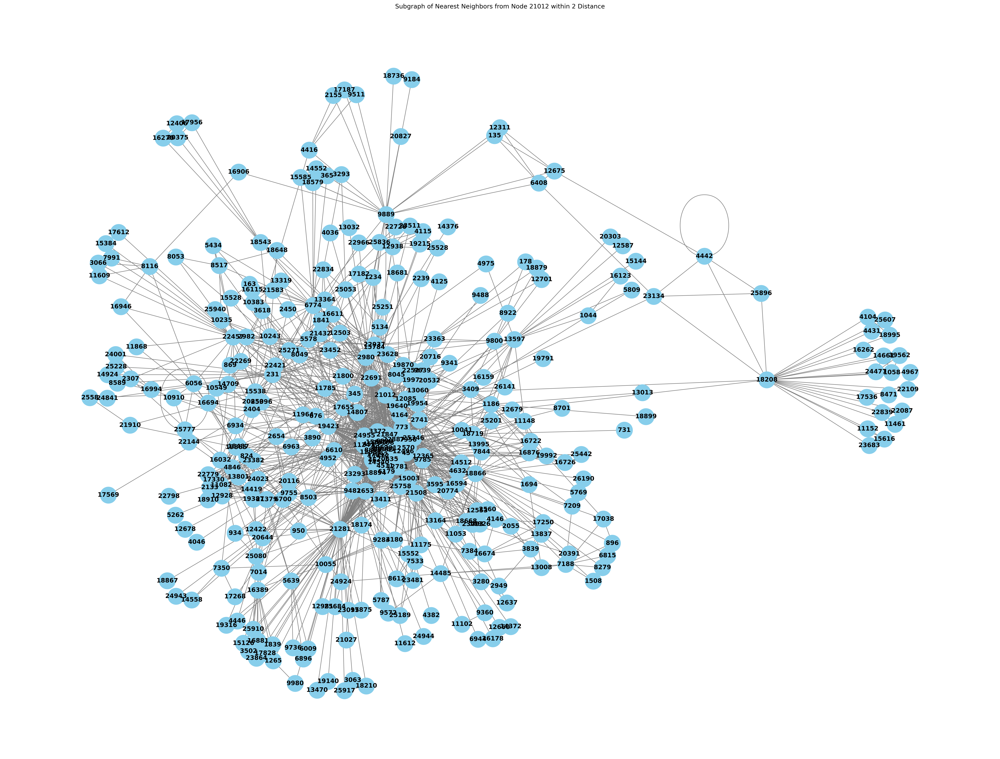

In [ ]:
# @title 11. Plot the Subgraph of the Most Prolific Author

start_node = '21012'
max_distance = 2
G = nx.Graph(mapped_nodes)

visited_nodes = {start_node}
current_nodes = [start_node]
next_nodes = []
for i in range(max_distance):
    for node in current_nodes:
        neighbors = G.neighbors(node)
        for neighbor in neighbors:
            if neighbor not in visited_nodes:
                visited_nodes.add(neighbor)
                next_nodes.append(neighbor)
    current_nodes = next_nodes
    next_nodes = []

H = G.subgraph(visited_nodes)
my_dpi = 300
plt.figure(figsize=(8000/my_dpi, 6000/my_dpi), dpi = my_dpi)
nx.draw(H, with_labels=True, font_weight='bold', node_size=1000, node_color='skyblue', edge_color='gray')
plt.title(f'Subgraph of Nearest Neighbors from Node {start_node} within {max_distance} Distance')
plt.savefig('subgraph.png', dpi = my_dpi)
plt.show()

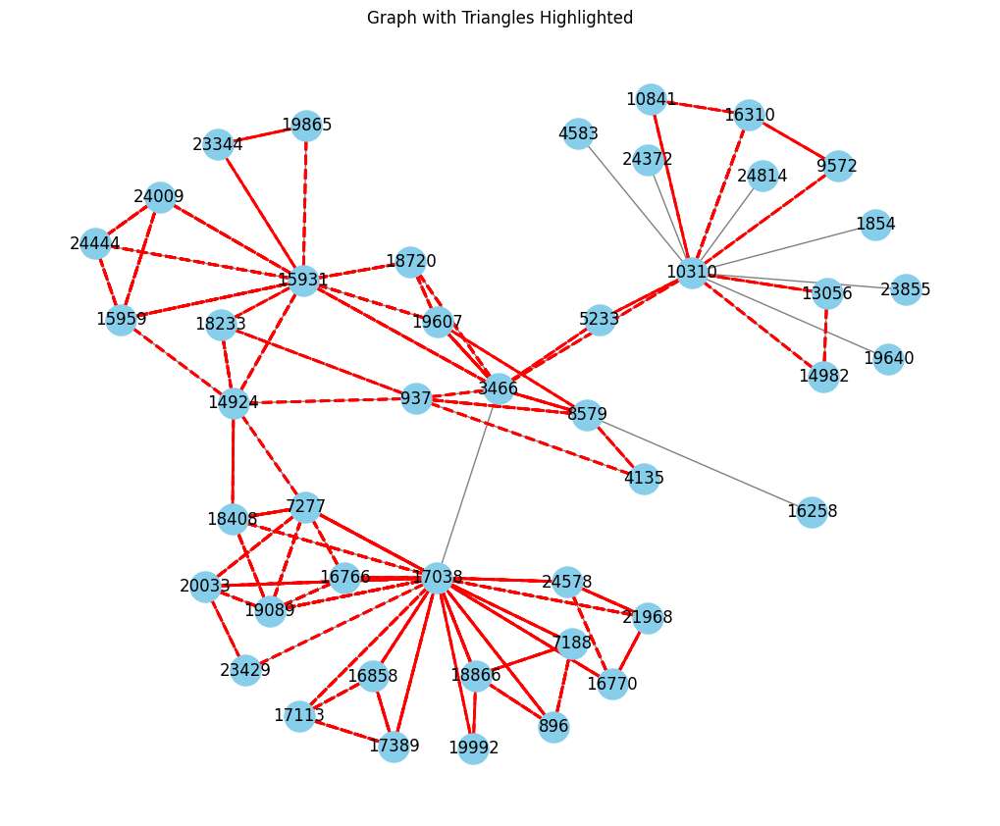

In [ ]:
# @title 12. Visualize the Triangles
start_node = '3466'
max_distance = 2
G = nx.Graph(mapped_nodes)

visited_nodes = {start_node}
current_nodes = [start_node]
next_nodes = []
for i in range(max_distance):
    for node in current_nodes:
        neighbors = G.neighbors(node)
        for neighbor in neighbors:
            if neighbor not in visited_nodes:
                visited_nodes.add(neighbor)
                next_nodes.append(neighbor)
    current_nodes = next_nodes
    next_nodes = []

H = G.subgraph(visited_nodes)
triangle_edges = []
for u, v in H.edges():
    for w in set(H[u]) & set(H[v]):
        if (v, w) in H.edges() or (w, v) in H.edges():
            triangle_edges.append((u, v))
            triangle_edges.append((u, w))
            triangle_edges.append((v, w))

plt.figure(figsize=(10, 8))
pos = nx.kamada_kawai_layout(H)
nx.draw(H, pos, with_labels=True, node_color='skyblue', node_size=500, edge_color='gray', width=1.0)
nx.draw_networkx_edges(G, pos, edgelist=triangle_edges, edge_color='red', width=2.0, style='dashed')
plt.title('Graph with Triangles Highlighted')
plt.savefig('triangles.png', dpi = my_dpi)
plt.show()

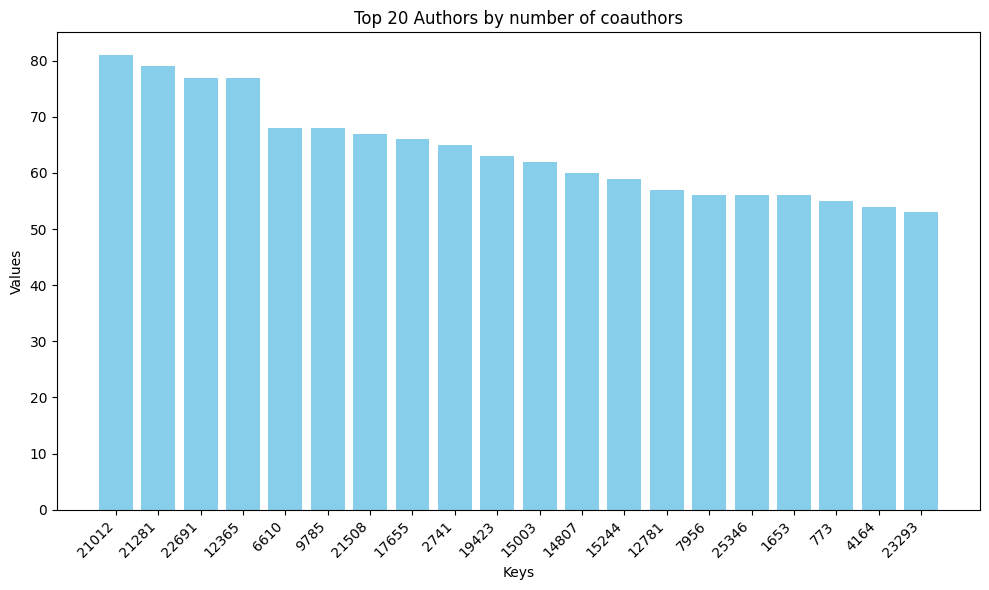

In [ ]:
# @title 13. Plot 20 Most Prolific Authors
sorted_keys_values = sorted(mapped_keys_values.items(), key=lambda x: x[1], reverse=True)

top_20_keys_values = sorted_keys_values[:20]
keys = [item[0] for item in top_20_keys_values]
values = [item[1] for item in top_20_keys_values]

plt.figure(figsize=(10, 6))
plt.bar(keys, values, color='skyblue')
plt.xlabel('Keys')
plt.ylabel('Values')
plt.title('Top 20 Authors by number of coauthors')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('top20.png', dpi = my_dpi)
plt.show()

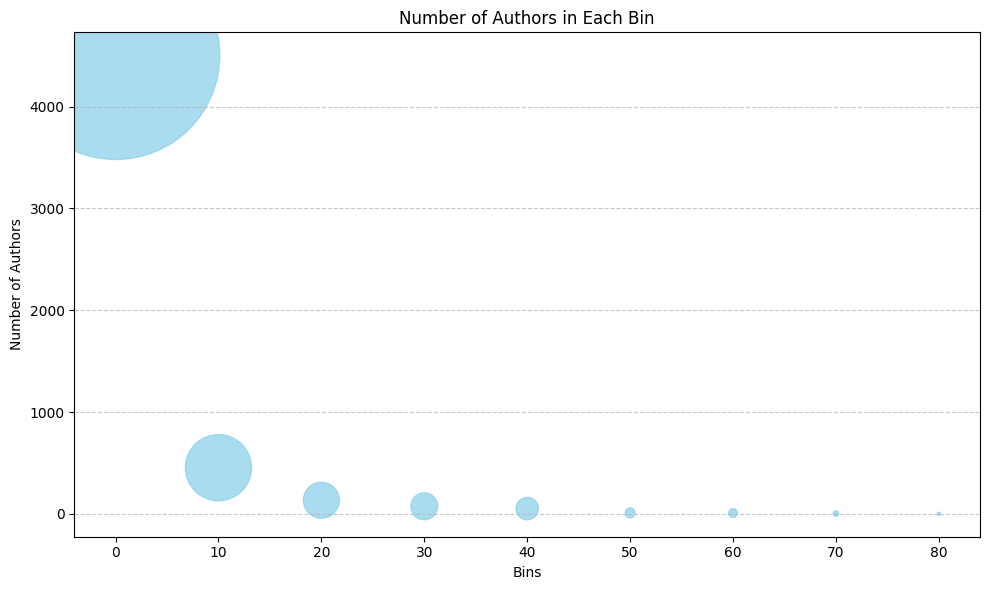

In [ ]:
# @title 14. Mapping Authors to Bins based on Co-Authoring and plotting them

value_bins = {}
for key, value in mapped_keys_values.items():
    bin_index = (value // 10) * 10
    if bin_index not in value_bins:
        value_bins[bin_index] = []
    value_bins[bin_index].append(key)

value_bins = {bin_val: keys if isinstance(keys, list) else [keys] for bin_val, keys in value_bins.items()}
bin_key_counts = {bin_val: len(keys) for bin_val, keys in value_bins.items()}

x_values = list(bin_key_counts.keys())
y_values = list(bin_key_counts.values())
plt.figure(figsize=(10, 6))
plt.scatter(x_values, y_values, s=[count * 5 for count in y_values], color='skyblue', alpha=0.7)
plt.xlabel('Bins')
plt.ylabel('Number of Authors')
plt.title('Number of Authors in Each Bin')
plt.xticks(range(0, max(bin_key_counts.keys()) + 10, 10))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig('bins.png', dpi = my_dpi)
plt.show()